<a href="https://colab.research.google.com/github/tanxy-2000/dive_into_deep_learning/blob/chapter11/add.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install d2l

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.6/112.6 KB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.2/61.2 KB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.7/9.7 MB 62.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.2/11.2 MB 86.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 65.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.2/121.2 KB 13.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 KB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.9/84.9 KB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 57.8 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.22.4
    Uninstalling numpy-1.22.4:
      Successfully uninstalled numpy-1.22.4
  Attempting uninstall: idna

In [ ]:
import tensorflow as tf
from d2l import tensorflow as d2l


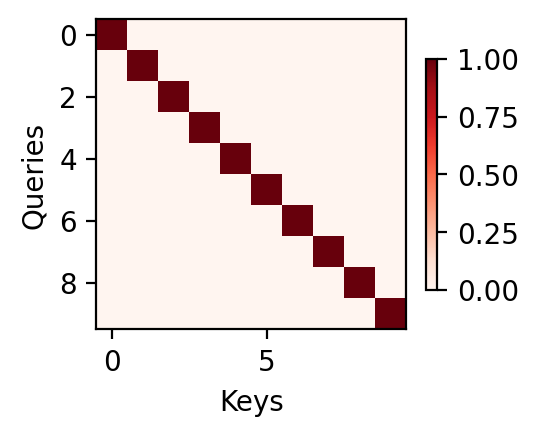

In [ ]:
#@title
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import tensorflow as tf
import matplotlib.pyplot as plt
from d2l import tensorflow as d2l

def show_heatmaps(matrices, xlabel, ylabel, titles=None, figsize=(2.5, 2.5),
                  cmap='Reds'):
    """Show heatmaps of matrices."""
    num_rows, num_cols, _, _ = matrices.shape
    fig, axes = d2l.plt.subplots(num_rows, num_cols, figsize=figsize,
                                 sharex=True, sharey=True, squeeze=False)
    for i, (row_axes, row_matrices) in enumerate(zip(axes, matrices)):
        for j, (ax, matrix) in enumerate(zip(row_axes, row_matrices)):
            pcm = ax.imshow(matrix.numpy(), cmap=cmap)
            if i == num_rows - 1:
                ax.set_xlabel(xlabel)
            if j == 0:
                ax.set_ylabel(ylabel)
            if titles:
                ax.set_title(titles[j])
    fig.colorbar(pcm, ax=axes, shrink=0.6);

attention_weights = tf.reshape(tf.eye(10), (1, 1, 10, 10))
show_heatmaps(attention_weights, xlabel='Keys', ylabel='Queries')


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import os

# 获取当前工作目录
os.getcwd()


'/content'

In [ ]:
import pandas as pd

# 获取 pandas 模块路径
pandas_path = os.path.abspath(pd.__file__)
print(pandas_path)


/usr/local/lib/python3.9/dist-packages/pandas/__init__.py


In [ ]:
import os

# 获取当前文件路径
current_path = os.path.abspath(__file__)
print(current_path)


NameError: ignored

In [ ]:
import os

# 获取当前工作目录
current_dir = os.getcwd()
print(current_dir)


/content


下面是11.2节的代码：some similarity kernel

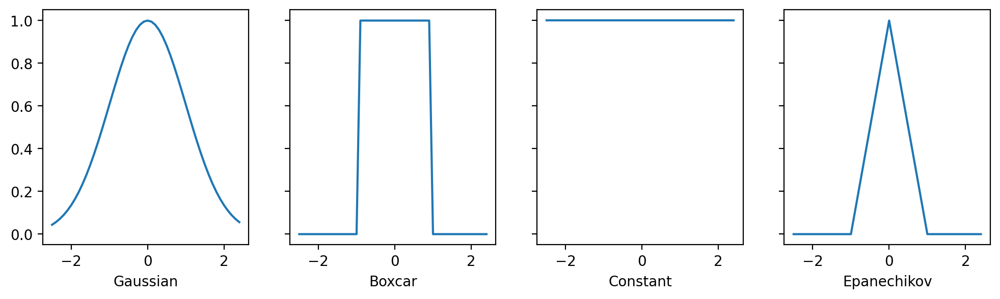

In [ ]:
#@title
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import tensorflow as tf
from d2l import tensorflow as d2l

fig, axes = d2l.plt.subplots(1, 4, sharey=True, figsize=(12, 3))

# Define some kernels
def gaussian(x):
    return tf.exp(-x**2 / 2)

def boxcar(x):
    return tf.abs(x) < 1.0

def constant(x):
    return 1.0 + 0 * x

def epanechikov(x):
    return tf.maximum(1 - tf.abs(x), 0)


kernels = (gaussian, boxcar, constant, epanechikov)
names = ('Gaussian', 'Boxcar', 'Constant', 'Epanechikov')
x = tf.range(-2.5, 2.5, 0.1)
for kernel, name, ax in zip(kernels, names, axes):
    ax.plot(x.numpy(), kernel(x).numpy())
    ax.set_xlabel(name)

11.2.2. Attention Pooling via Nadaraya-Watson Regression

In [ ]:
#生成数据
def f(x):
    return 2 * tf.sin(x) + x

n = 40
x_train = tf.sort(tf.random.uniform((n,1)) * 5, 0)
y_train = f(x_train) + tf.random.normal((n, 1))
x_val = tf.range(0, 5, 0.1)
y_val = f(x_val)

In [ ]:
# 各种kernel采用train data 拟合出val data 的结果
def nadaraya_watson(x_train, y_train, x_val, kernel):
    dists = tf.reshape(x_train, (-1, 1)) - tf.reshape(x_val, (1, -1))
    # Each column/row corresponds to each query/key
    k = tf.cast(kernel(dists), tf.float32)
    # Normalization over keys for each query
    attention_w = k / tf.reduce_sum(k, 0)
    y_hat = tf.transpose(tf.transpose(y_train)@attention_w)
    return y_hat, attention_w

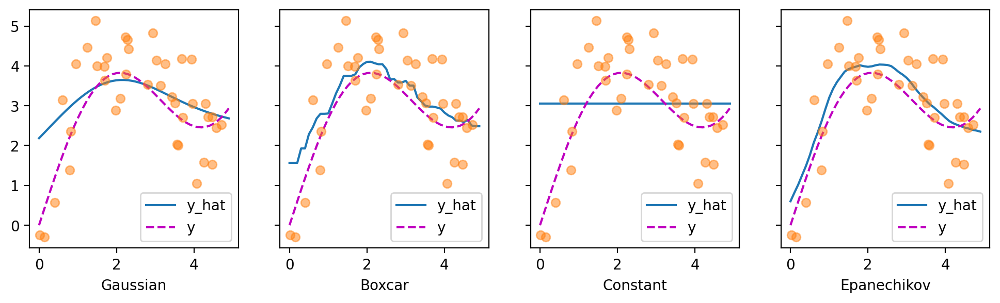

In [ ]:
# 定义画图展示结果
def plot(x_train, y_train, x_val, y_val, kernels, names, attention=False):
    fig, axes = d2l.plt.subplots(1, 4, sharey=True, figsize=(12, 3))
    for kernel, name, ax in zip(kernels, names, axes):
        y_hat, attention_w = nadaraya_watson(x_train, y_train, x_val, kernel)
        if attention:
            pcm = ax.imshow(attention_w.numpy(), cmap='Reds')
        else:
            ax.plot(x_val, y_hat)
            ax.plot(x_val, y_val, 'm--')
            ax.plot(x_train, y_train, 'o', alpha=0.5);
        ax.set_xlabel(name)
        if not attention:
            ax.legend(['y_hat', 'y'])
    if attention:
        fig.colorbar(pcm, ax=axes, shrink=0.7)

plot(x_train, y_train, x_val, y_val, kernels, names)

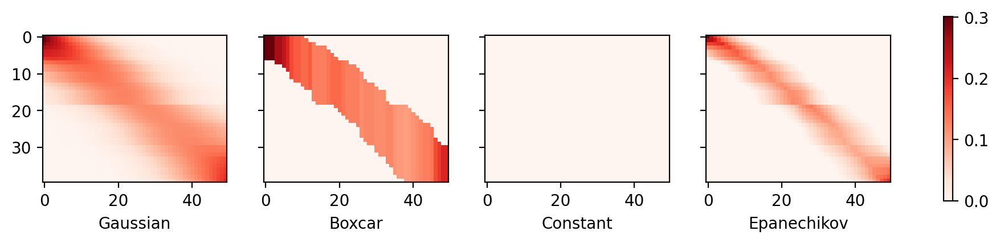

In [ ]:
#展示similar attention weights,显示为什么上图几个kernel拟合效果差不多
plot(x_train, y_train, x_val, y_val, kernels, names, attention=True)

11.2.3 adapting attention pooling 

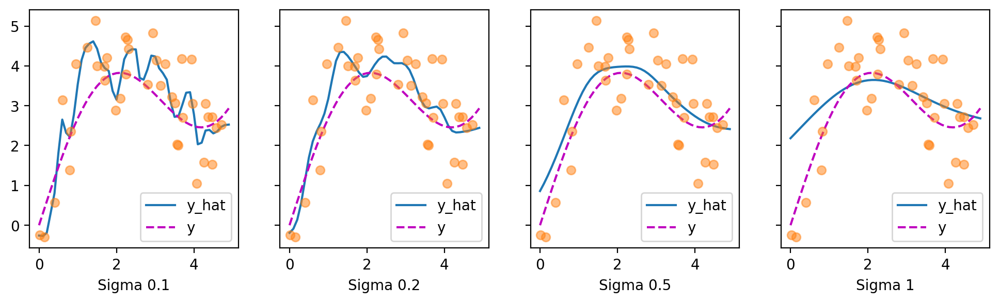

In [10]:
#replace the Gaussian kernel with one of a different width

# sigmas代表高斯分布的方差，方差越大，对应的高斯核越矮胖，意味着某个点由周围更多的点决定
#学术上称sigmas为gaussian kernel's width 
sigmas = (0.1, 0.2, 0.5, 1)
names = ['Sigma ' + str(sigma) for sigma in sigmas]

def gaussian_with_width(sigma):
    return (lambda x: tf.exp(-x**2 / (2*sigma**2)))

kernels = [gaussian_with_width(sigma) for sigma in sigmas]
plot(x_train, y_train, x_val, y_val, kernels, names)

11.2.5 第二题的第一问

Epoch [1/500], Loss: 58.5056, Sigma: 0.4990
Epoch [51/500], Loss: 48.0110, Sigma: 0.4494
Epoch [101/500], Loss: 38.5268, Sigma: 0.4014
Epoch [151/500], Loss: 30.1353, Sigma: 0.3553
Epoch [201/500], Loss: 22.9018, Sigma: 0.3117
Epoch [251/500], Loss: 16.8938, Sigma: 0.2710
Epoch [301/500], Loss: 12.1537, Sigma: 0.2339
Epoch [351/500], Loss: 8.6592, Sigma: 0.2011
Epoch [401/500], Loss: 6.2855, Sigma: 0.1732
Epoch [451/500], Loss: 4.7986, Sigma: 0.1505


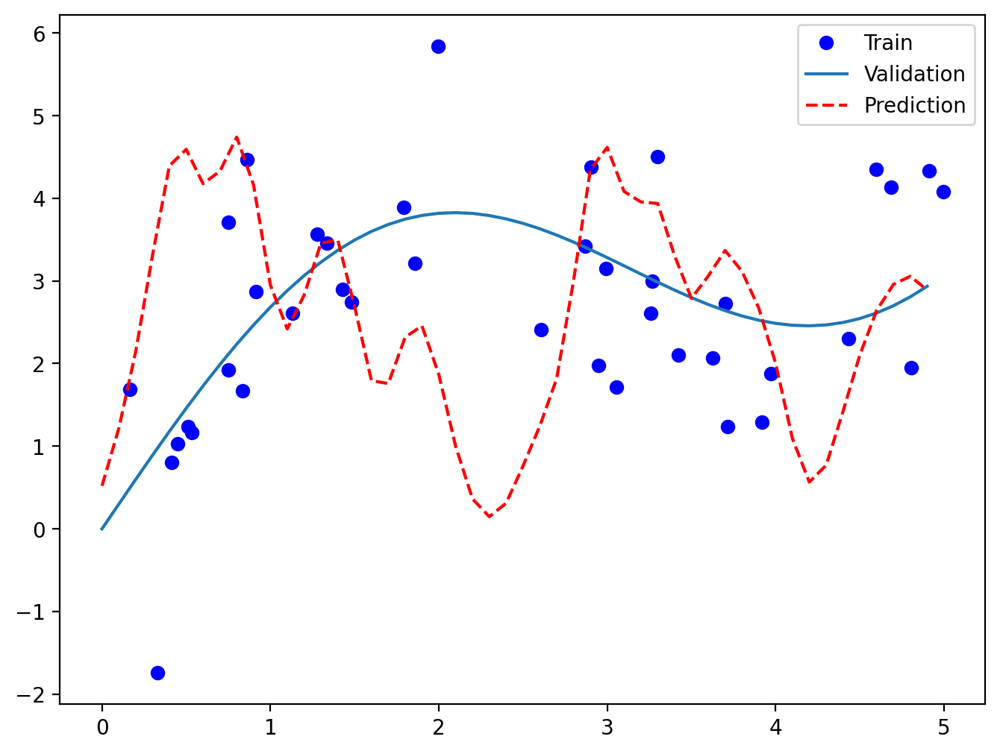

In [11]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# 定义函数 f(x)
def f(x):
    return 2 * tf.sin(x) + x

# 生成训练集和验证集
n = 40
x_train = tf.sort(tf.random.uniform((n,1)) * 5, 0)
y_train = f(x_train) + tf.random.normal((n, 1))
x_val = tf.range(0, 5, 0.1)
y_val = f(x_val)

# 定义高斯核函数
def gaussian_with_width(sigma):
    return (lambda x: tf.exp(-x**2 / (2*sigma**2)))

# 定义损失函数
def mse_loss(y_pred, y_true):
    return tf.reduce_mean(tf.square(y_pred - y_true))

# 初始化参数
sigma = tf.Variable(0.5, dtype=tf.float32)

# 定义优化器和学习率
optimizer = tf.optimizers.Adam()
lr = 0.01

# 训练模型
for epoch in range(500):
    with tf.GradientTape() as tape:
        # 计算训练集上的预测值
        kernels = [gaussian_with_width(sigma)]
        y_pred_train = sum([kernel(x_train - xi) for kernel in kernels for xi in x_train])
        # 计算损失函数值
        loss = mse_loss(y_pred_train, y_train)
    # 计算参数的梯度
    grads = tape.gradient(loss, sigma)
    # 更新参数
    optimizer.apply_gradients([(grads, sigma)])
    # 输出训练过程
    if epoch % 50 == 0:
        print('Epoch [{}/{}], Loss: {:.4f}, Sigma: {:.4f}'.format(
            epoch+1, 500, loss.numpy(), sigma.numpy()))

# 计算验证集上的预测值
kernels = [gaussian_with_width(sigma)]
y_pred_val = sum([kernel(x_val - xi) for kernel in kernels for xi in x_train])

# 绘制图像
plt.figure(figsize=(8, 6))
plt.plot(x_train, y_train, 'bo', label='Train')
plt.plot(x_val, y_val, label='Validation')
plt.plot(x_val, y_pred_val, 'r--', label='Prediction')
plt.legend()
plt.show()


图像可见，确实产生了过拟合

Epoch [1/500], Loss: 13180.7939, Sigma: 0.4990
Epoch [51/500], Loss: 13158.1436, Sigma: 0.4484
Epoch [101/500], Loss: 13127.0000, Sigma: 0.3925
Epoch [151/500], Loss: 13069.6631, Sigma: 0.3246
Epoch [201/500], Loss: 12940.8457, Sigma: 0.2397
Epoch [251/500], Loss: 12525.8438, Sigma: 0.1292
Epoch [301/500], Loss: nan, Sigma: nan
Epoch [351/500], Loss: nan, Sigma: nan
Epoch [401/500], Loss: nan, Sigma: nan
Epoch [451/500], Loss: nan, Sigma: nan


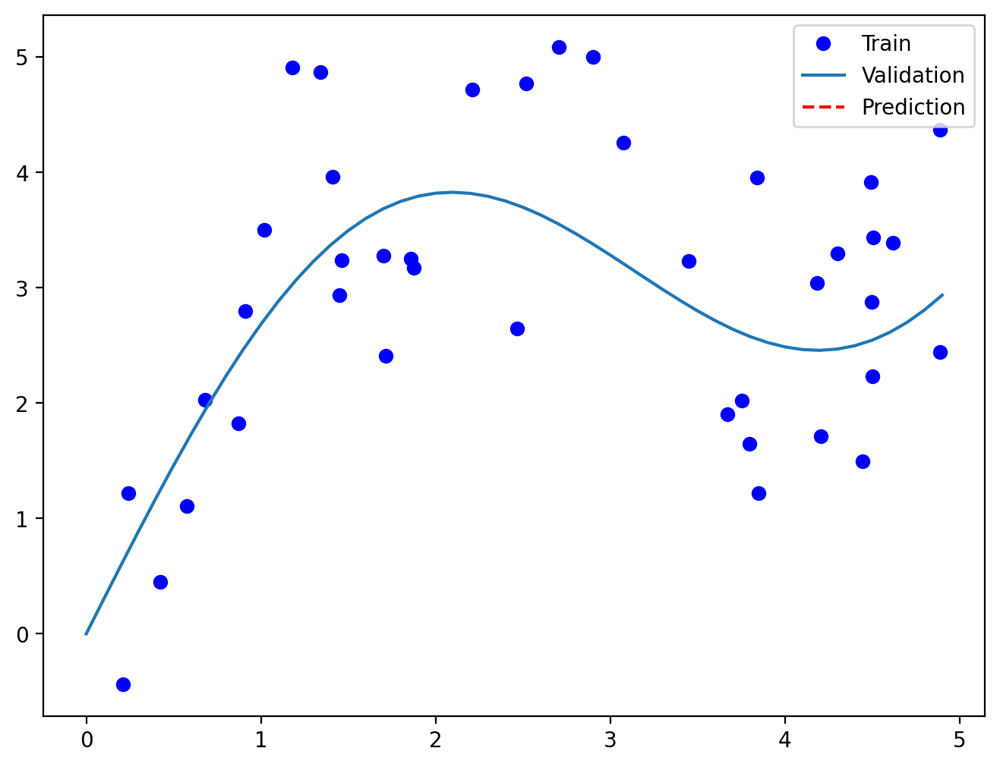

In [13]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# 定义函数 f(x)
def f(x):
    return 2 * tf.sin(x) + x

# 生成训练集和验证集
n = 40
x_train = tf.sort(tf.random.uniform((n,1)) * 5, 0)
y_train = f(x_train) + tf.random.normal((n, 1))
x_val = tf.range(0, 5, 0.1)
y_val = f(x_val)

# 定义高斯核函数
#def gaussian_with_width(sigma):
#    return (lambda x: tf.exp(-x**2 / (2*sigma**2)))
#训练出现Loss nan,尝试原有的高斯核函数基础上增加了一个很小的正数 eps，并在指数函数的分母中使用了 sigma**2+eps 替代了原来的 2*sigma**2。
def gaussian_with_width(sigma):
    eps = 1e-8
    return (lambda x: tf.exp(-x**2 / (2*(sigma**2+eps))) / tf.sqrt(2*np.pi*sigma**2+eps))


# 定义损失函数
def mse_loss(y_pred, y_true):
    return tf.reduce_mean(tf.square(y_pred - y_true))

# 初始化参数
sigma = tf.Variable(0.5, dtype=tf.float32)

# 定义优化器和学习率
optimizer = tf.optimizers.Adam()
lr = 0.01

# 训练模型
for epoch in range(500):
    with tf.GradientTape() as tape:
        # 计算训练集上的预测值
        kernels = [gaussian_with_width(sigma)]
        y_pred_train = 0
        for i in range(n):
            xi = x_train[i]
            yi = y_train[i]
            Ki = kernels[0](tf.abs(x_train - xi))
            y_pred_train += (tf.reduce_sum(Ki*y_train) - Ki[i]*yi)/(tf.reduce_sum(Ki) - Ki[i])
        # 计算损失函数值
        loss = mse_loss(y_pred_train, y_train)
    # 计算参数的梯度
    grads = tape.gradient(loss, sigma)
    # 更新参数
    optimizer.apply_gradients([(grads, sigma)])
    # 输出训练过程
    if epoch % 50 == 0:
        print('Epoch [{}/{}], Loss: {:.4f}, Sigma: {:.4f}'.format(
            epoch+1, 500, loss.numpy(), sigma.numpy()))

# 计算验证集上的预测值
kernels = [gaussian_with_width(sigma)]
y_pred_val = sum([kernel(x_val - xi) for kernel in kernels for xi in x_train])

# 绘制图像
plt.figure(figsize=(8, 6))
plt.plot(x_train, y_train, 'bo', label='Train')
plt.plot(x_val, y_val, label='Validation')
plt.plot(x_val, y_pred_val, 'r--', label='Prediction')
plt.legend()
plt.show()


训练过程中出现了loss nan,下面尝试通过调整学习率


Epoch [1/500], Loss: 10723.8643, Sigma: 0.4990
Epoch [51/500], Loss: 10719.3105, Sigma: 0.4554
Epoch [101/500], Loss: 10717.5840, Sigma: 0.4239
Epoch [151/500], Loss: 10715.4863, Sigma: 0.3879
Epoch [201/500], Loss: 10711.9434, Sigma: 0.3397
Epoch [251/500], Loss: 10711.0410, Sigma: 0.3150
Epoch [301/500], Loss: 10711.0449, Sigma: 0.3154
Epoch [351/500], Loss: 10711.0410, Sigma: 0.3154
Epoch [401/500], Loss: 10711.0410, Sigma: 0.3154
Epoch [451/500], Loss: 10711.0410, Sigma: 0.3154


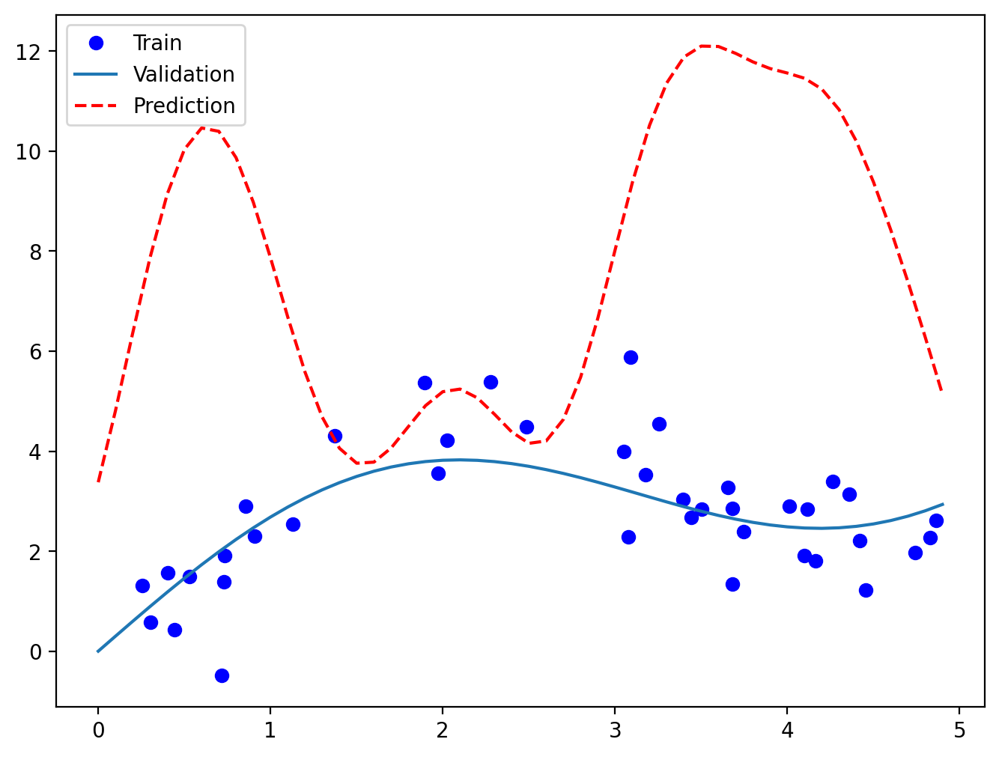

In [14]:
#第一种尝试：一个更小的学习率10^(-3)
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# 定义函数 f(x)
def f(x):
    return 2 * tf.sin(x) + x

# 生成训练集和验证集
n = 40
x_train = tf.sort(tf.random.uniform((n,1)) * 5, 0)
y_train = f(x_train) + tf.random.normal((n, 1))
x_val = tf.range(0, 5, 0.1)
y_val = f(x_val)

# 定义高斯核函数
def gaussian_with_width(sigma):
    eps = 1e-8
    return (lambda x: tf.exp(-x**2 / (2*(sigma**2+eps))) / tf.sqrt(2*np.pi*sigma**2+eps))

# 定义损失函数
def mse_loss(y_pred, y_true):
    return tf.reduce_mean(tf.square(y_pred - y_true))

# 初始化参数
sigma = tf.Variable(0.5, dtype=tf.float32)

# 定义优化器和学习率
optimizer = tf.optimizers.Adam(learning_rate=1e-3)

# 训练模型
for epoch in range(500):
    with tf.GradientTape() as tape:
        # 计算训练集上的预测值
        kernels = [gaussian_with_width(sigma)]
        y_pred_train = 0
        for i in range(n):
            xi = x_train[i]
            yi = y_train[i]
            Ki = kernels[0](tf.abs(x_train - xi))
            y_pred_train += (tf.reduce_sum(Ki*y_train) - Ki[i]*yi)/(tf.reduce_sum(Ki) - Ki[i])
        # 计算损失函数值
        loss = mse_loss(y_pred_train, y_train)
    # 计算参数的梯度
    grads = tape.gradient(loss, sigma)
    # 更新参数
    optimizer.apply_gradients([(grads, sigma)])
    # 输出训练过程
    if epoch % 50 == 0:
        print('Epoch [{}/{}], Loss: {:.4f}, Sigma: {:.4f}'.format(
            epoch+1, 500, loss.numpy(), sigma.numpy()))

# 计算验证集上的预测值
kernels = [gaussian_with_width(sigma)]
y_pred_val = sum([kernel(x_val - xi) for kernel in kernels for xi in x_train])

# 绘制图像
plt.figure(figsize=(8, 6))
plt.plot(x_train, y_train, 'bo', label='Train')
plt.plot(x_val, y_val, label='Validation')
plt.plot(x_val, y_pred_val, 'r--', label='Prediction')
plt.legend()
plt.show()


使用学习率预热方式

In [16]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# 定义函数 f(x)
def f(x):
    return 2 * tf.sin(x) + x

# 生成训练集和验证集
n = 40
x_train = tf.sort(tf.random.uniform((n,1)) * 5, 0)
y_train = f(x_train) + tf.random.normal((n, 1))
x_val = tf.range(0, 5, 0.1)
y_val = f(x_val)

# 定义高斯核函数
def gaussian_with_width(sigma):
    eps = 1e-8
    return (lambda x: tf.exp(-x**2 / (2*(sigma**2+eps))) / tf.sqrt(2*np.pi*sigma**2+eps))

# 定义损失函数
def mse_loss(y_pred, y_true):
    return tf.reduce_mean(tf.square(y_pred - y_true))

# 初始化参数
sigma = tf.Variable(0.5, dtype=tf.float32)

# 定义优化器和学习率
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-3, decay_steps=5000, decay_rate=0.9)
optimizer = tf.optimizers.Adam(learning_rate=lr_schedule)

# 训练模型
for epoch in range(500):
    with tf.GradientTape() as tape:
        # 计算训练集上的预测值
        kernels = [gaussian_with_width(sigma)]
        y_pred_train = 0
        for i in range(n):
            xi = x_train[i]
            yi = y_train[i]
            Ki = kernels[0](tf.abs(x_train - xi))
            y_pred_train += (tf.reduce_sum(Ki*y_train) - Ki[i]*yi)/(tf.reduce_sum(Ki) - Ki[i])
        # 计算损失函数值
        loss = mse_loss(y_pred_train, y_train)
    # 计算参数的梯度
    grads = tape.gradient(loss, sigma)
    # 更新参数
    optimizer.apply_gradients([(grads, sigma)])
    # 输出训练过程
    if epoch % 50 == 0:
        print('Epoch [{}/{}], Loss: {:.4f}, Sigma: {:.4f}'.format(
            epoch+1, 500, loss.numpy(), sigma.numpy()))

# 计算验证集上的预测值
kernels = [gaussian_with_width(sigma)]
y_pred_val = sum([kernel(x_val - xi) for kernel in kernels for xi in x_train])

# 绘制图像
plt.figure(figsize=(8, 6))
plt.plot(x_train, y_train, 'bo', label='Train')
plt.plot(x_val, y_val, label='Validation')
plt.plot(x_val, y_pred_val, 'r--', label='Prediction')
plt.legend()
plt.show()


Epoch [1/500], Loss: 1294379.8750, Sigma: 0.4990


KeyboardInterrupt: ignored

下面使用实例演示Nadaraya-Watson estimation is consistent.也就是
1）随着样本数量的增加，估计结果将越来越接近真实的概率密度函数。
2）在实践中，随着数据量的增加，我们可以逐渐减小高斯核函数的带宽参数，以获得更精确的估计结果。

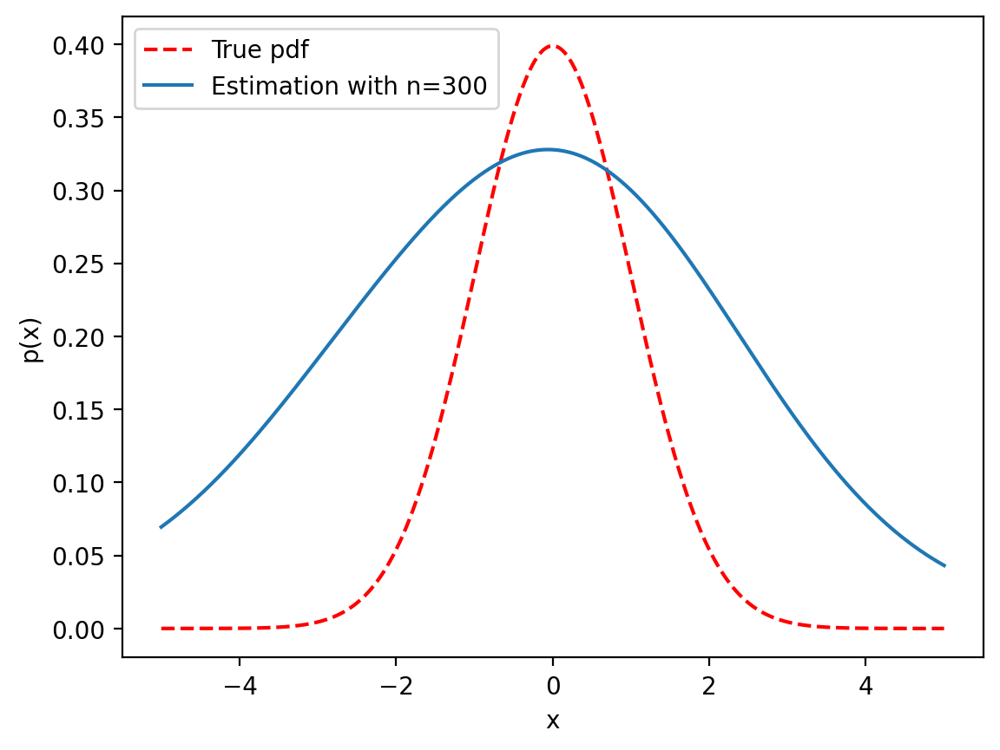

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML

# 构造正态分布的概率密度函数
def normal_pdf(x, mu, sigma):
    return 1.0 / (sigma * np.sqrt(2*np.pi)) * np.exp(-0.5 * ((x-mu)/sigma)**2)

# 生成服从正态分布的随机样本
mu, sigma = 0.0, 1.0
n_samples = 1000
x_samples = np.random.normal(mu, sigma, n_samples)

# 生成一些用于估计概率密度函数的输入点
x_grid = np.linspace(mu - 5*sigma, mu + 5*sigma, num=1000)

# 定义核函数
def gaussian_kernel(x, x_i, h):
    return np.exp(-(x - x_i)**2 / (2 * h**2)) / np.sqrt(2*np.pi) / h

# 定义 Nadaraya-Watson 估计器
def nadaraya_watson_estimator(x, x_samples, h):
    weights = gaussian_kernel(x, x_samples, h)
    p = np.sum(weights * normal_pdf(x_samples, mu, sigma)) / np.sum(weights)
    return p

# 估计概率密度函数
h = 1.0
n_estimations = 300
pdf_estimations = np.zeros((n_estimations, len(x_grid)))
for i in range(n_estimations):
    # 逐步增加样本数量
    x_samples_subset = x_samples[:i+1]
    #h = sigma * (i+1) ** (-0.2)
    # 对每个输入点进行估计
    for j, x in enumerate(x_grid):
        pdf_estimations[i,j] = nadaraya_watson_estimator(x, x_samples_subset, h)

# 动态绘制概率密度函数的估计结果
fig, ax = plt.subplots()
ax.plot(x_grid, normal_pdf(x_grid, mu, sigma), 'r--', label='True pdf')
line, = ax.plot([], [], label='Estimation with n=0')
ax.set_xlabel('x')
ax.set_ylabel('p(x)')
ax.legend(loc='upper left')

def update(i):
    line.set_data(x_grid, pdf_estimations[i])
    line.set_label('Estimation with n={}'.format(i+1))
    ax.legend(loc='upper left')
    return line,

ani = animation.FuncAnimation(fig, update, frames=n_estimations, interval=500, blit=True)
HTML(ani.to_jshtml())


1.上图增大训练样本数目到300,拟合曲线接近正态分布的形态，但是方差是固定的，导致拟合效果还不够好，加入方差调整公式
h = sigma * (i+1) ** (-0.2)，
其中这里的i指的是当前已经使用的样本数目，参数 0.2 是经验调整得到的。
2.根据这个公式，当样本数量增加时，方差会随之减小。这种方式可以在初始时使用较大的方差来防止过拟合，随着样本数量的增加逐渐减小方差，以提高估计的准确性。

/usr/local/lib/python3.9/dist-packages/matplotlib/animation.py:889: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you have outputted the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


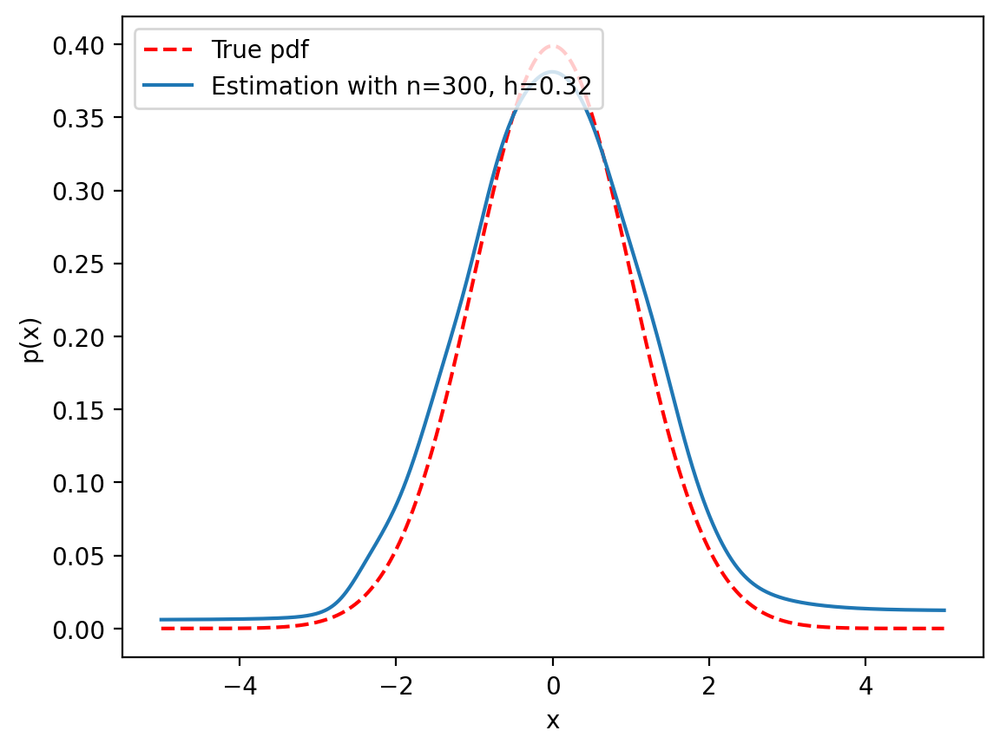

In [34]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML

# 构造正态分布的概率密度函数
def normal_pdf(x, mu, sigma):
    return 1.0 / (sigma * np.sqrt(2*np.pi)) * np.exp(-0.5 * ((x-mu)/sigma)**2)

# 生成服从正态分布的随机样本
mu, sigma = 0.0, 1.0
n_samples = 1000
x_samples = np.random.normal(mu, sigma, n_samples)

# 生成一些用于估计概率密度函数的输入点
x_grid = np.linspace(mu - 5*sigma, mu + 5*sigma, num=1000)

# 定义核函数
def gaussian_kernel(x, x_i, h):
    return np.exp(-(x - x_i)**2 / (2 * h**2)) / np.sqrt(2*np.pi) / h

# 定义 Nadaraya-Watson 估计器
def nadaraya_watson_estimator(x, x_samples, h):
    weights = gaussian_kernel(x, x_samples, h)
    p = np.sum(weights * normal_pdf(x_samples, mu, sigma)) / np.sum(weights)
    return p

# 估计概率密度函数
#h = 1.0
n_estimations = 300
pdf_estimations = np.zeros((n_estimations, len(x_grid)))
h_values = np.zeros(n_estimations)  # 存储每次估计的h值
for i in range(n_estimations):
    # 逐步增加样本数量
    x_samples_subset = x_samples[:i+1]
    h = sigma * (i+1) ** (-0.2)
    h_values[i] = h
    # 对每个输入点进行估计
    for j, x in enumerate(x_grid):
        pdf_estimations[i,j] = nadaraya_watson_estimator(x, x_samples_subset, h)

# 动态绘制概率密度函数的估计结果
fig, ax = plt.subplots()
ax.plot(x_grid, normal_pdf(x_grid, mu, sigma), 'r--', label='True pdf')
line, = ax.plot([], [], label='Estimation with n=0')
ax.set_xlabel('x')
ax.set_ylabel('p(x)')
ax.legend(loc='upper left')

def update(i):
    global h_values

    line.set_data(x_grid, pdf_estimations[i])
    line.set_label('Estimation with n={}, h={:.2f}'.format(i+1, h_values[i]))
    ax.legend(loc='upper left')
    return line,

ani = animation.FuncAnimation(fig, update, frames=n_estimations, interval=500, blit=True)
HTML(ani.to_jshtml())
